# Visualizing Linear Transformations

## Primitives

In [ ]:
def identity():
    def id(t):
        I = [[1, 0], [0, 1]]
        return matrix(I)
    return id

def rotation(theta):
    def rot(t):
        A = [[cos(theta*t), -sin(theta*t)],
            [sin(theta*t), cos(theta*t)]]
        return matrix(A)
    return rot

def reflection(theta):
    # make a vector orthogonal to the angle given for the Householder transformation
    v = vector([cos(theta + pi/2), sin(theta + pi/2)])
    I = identity()
    def ref(t):
        A = I(t) - 2*t*v.outer_product(v)
        return matrix(A)
    return ref
    
def scaling(d1, d2):
    def scl(t):
        A = [[(1-t) + d1*t, 0], [0, (1-t) + d2*t]]
        return matrix(A)
    return scl

In [4]:
var('t')
show(identity()(t), rotation(pi/2)(t), reflection(pi/2)(t), scaling(3/4, 2)(t))

[1 0]
[0 1] [ cos(1/2*pi*t) -sin(1/2*pi*t)]
[ sin(1/2*pi*t)  cos(1/2*pi*t)] [-2*t + 1        0]
[       0        1] [-1/4*t + 1          0]
[         0      t + 1]

## Plotting And Animation

In [2]:
def transformed_circle_coords(A, x):
    return vector(matrix(A)*matrix(2, 1, [cos(x), sin(x)]))

def plot_transformed_circle(A, alpha=1.0):
    A = matrix(RDF, A)
    c = parametric_plot(transformed_circle_coords(A, x), (x, 0, 2*pi+0.1),
                        color = "black", alpha=alpha)
    c_1 = parametric_plot(transformed_circle_coords(A, x), (x, -pi, 0),
                          alpha=0.0,
                          fill=True, fillcolor = "blue", fillalpha=alpha*0.25)
    c_2 = parametric_plot(transformed_circle_coords(A, x), (x, pi/2, 3*pi/2),
                          alpha=0.0,
                          fill=True, fillcolor = "red", fillalpha=alpha*0.1)
    v_1 = plot(A * vector([0, 1]), 
               rgbcolor = (1.0, 1.0-alpha, 1.0-alpha))
    v_2 = plot(A * vector([1, 0]),
               rgbcolor = (1.0-alpha, 1.0-alpha, 1.0))               
    return plot(c + c_1 + c_2 + v_1 + v_2)

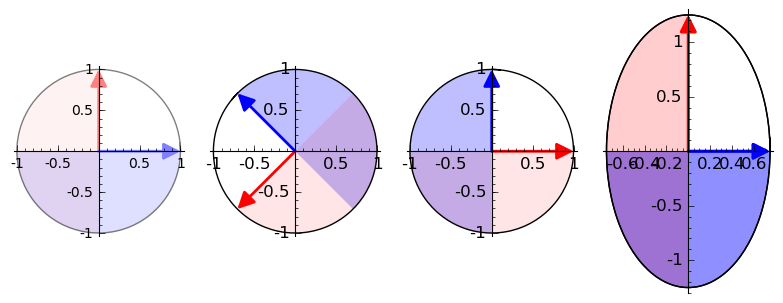

In [47]:
primitives = graphics_array((plot_transformed_circle(identity()(1.0), alpha = 0.5),
                            plot_transformed_circle(rotation(3*pi/4)(1.0), alpha = 1.0),
                            plot_transformed_circle(reflection(pi/4)(1.0), alpha = 1.0),
                            plot_transformed_circle(scaling(0.75, 1.25)(1.0), alpha = 1.0)))
primitives.save("primitives.png")
primitives

In [4]:
e_1 = vector([1, 0])
e_2 = vector([0, 1])

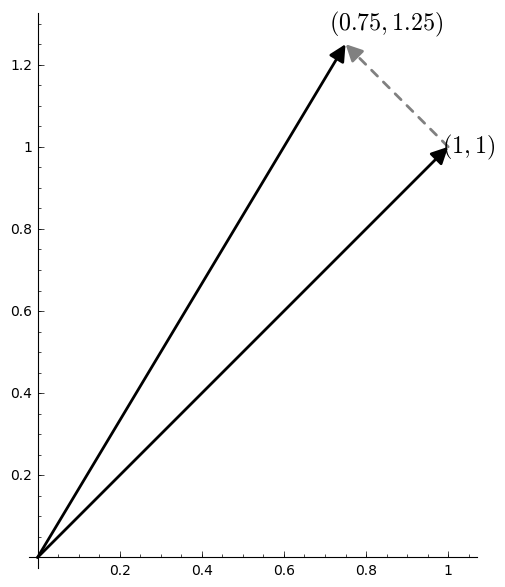

In [35]:
A_scaling = matrix(RDF, [[0.75, 0], [0, 1.25]])
vector_scaled = A_scaling * (e_1 + e_2)
img = (plot(e_1 + e_2, color = "black", aspect_ratio = 1) + 
 plot(vector_scaled, color = "black") + 
 arrow2d((1, 1), (0.75, 1.25), linestyle = "dashed", color = "gray") +
 text("$(1, 1)$", (1.05, 1), fontsize = "x-large", color = "black") +
 text("$(0.75, 1.25)$", (0.85, 1.30), fontsize = "x-large", color = "black"))
img.save("vector-scaled.png")
img

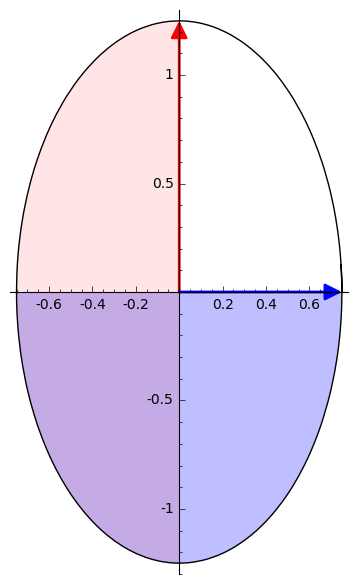

In [75]:
img = plot_transformed_circle(scaling(0.75, 1.25)(1.0))
img.save("circle-scaled.png")
img

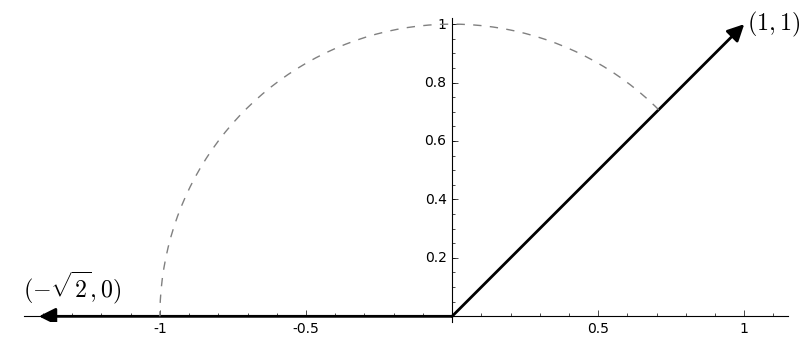

In [9]:
A_rotation = rotation(3*pi/4)(1.0)
vector_rotated = A_rotation * (e_1 + e_2)
img = (plot(e_1 + e_2, color = "black") + 
 plot(vector_rotated, color = "black") + 
 arc(center = (0, 0), r1 = 1, angle = pi/4, sector = (0, 3*pi/4), linestyle = "dashed", color = "gray") +
 text("$(1, 1)$", (1.1, 1), fontsize = "x-large", color = "black") +
 text("$(-\sqrt{2}, 0)$", (-1.3, .1), fontsize = "x-large", color = "black"))
img.save("vector-rotated.png")
img

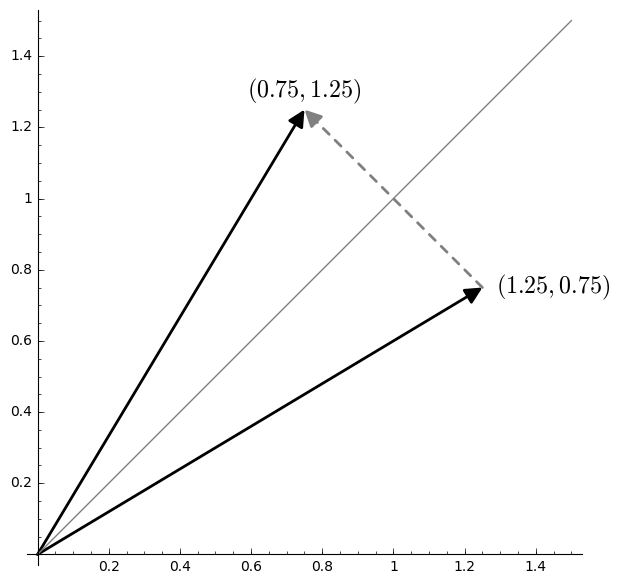

In [20]:
A_reflection = reflection(pi/4)(1.0)
vector_reflected = A_reflection * (1.25*e_1 + 0.75*e_2)
img = (plot(1.25*e_1 + 0.75*e_2, color = "black", aspect_ratio = 1) + 
 plot(vector_reflected, color = "black") + 
 arrow2d((1.25, 0.75), (0.75, 1.25), linestyle = "dashed", color = "gray") +
 line([(0,0), (1.5, 1.5)], color = "gray") +
 text("$(1.25, 0.75)$", (1.45, 0.75), fontsize = "x-large", color = "black") +
 text("$(0.75, 1.25)$", (0.75, 1.30), fontsize = "x-large", color = "black"))
img.save("vector-reflected.png")
img

In [26]:
def animate_transformation(A, steps = 50, end_pause = 5, **args):
    frames = []
    start = plot_transformed_circle(A(0.0), alpha = 0.1)
    end = plot_transformed_circle(A(1.0), alpha = 0.1)
    for t in srange(0, 1, 1/steps):
        transition = plot_transformed_circle(A(t), alpha = 1.0)
        frames.append(start + end + transition)
    end = plot_transformed_circle(A(1.0), alpha = 1.0)
    for _ in range(end_pause):
        frames.append(start + end)
    return animate(frames, xmin=-2, xmax=2, ymin=-2, ymax=2)

Animation with 60 frames
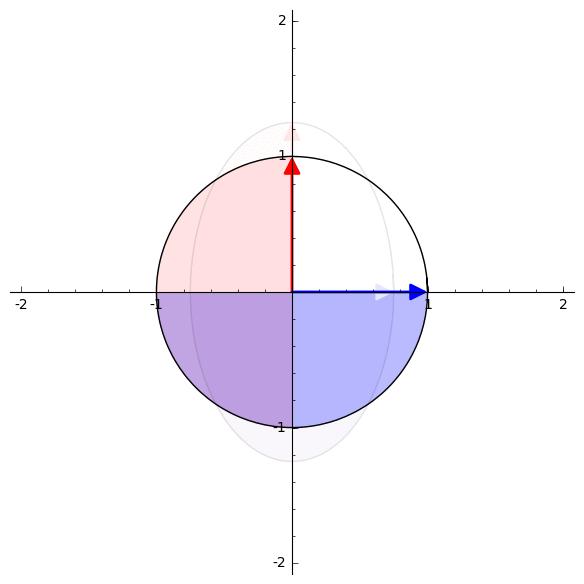

In [34]:
scaled_gif = animate_transformation(scaling(0.75, 1.25), steps = 50, end_pause = 10)
scaled_gif.save("scaling.gif", delay = 0)
scaled_gif

Animation with 110 frames
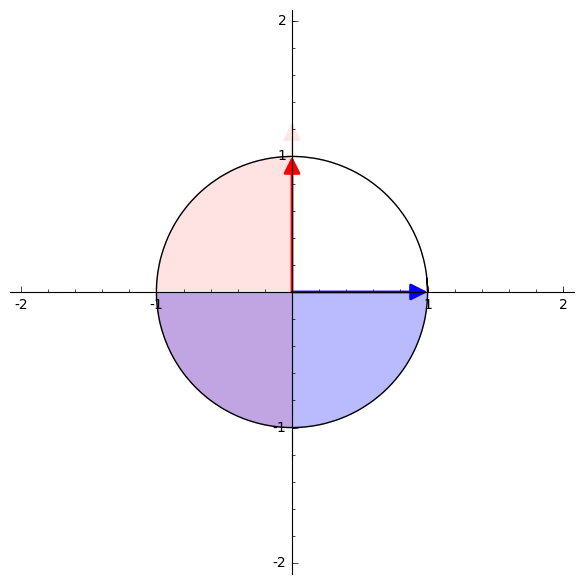

In [91]:
collapsed_gif = animate_transformation(scaling(0.0, 1.25), steps = 100, end_pause = 10)
collapsed_gif.save("collapsed.gif", delay = 0)
collapsed_gif

Animation with 60 frames
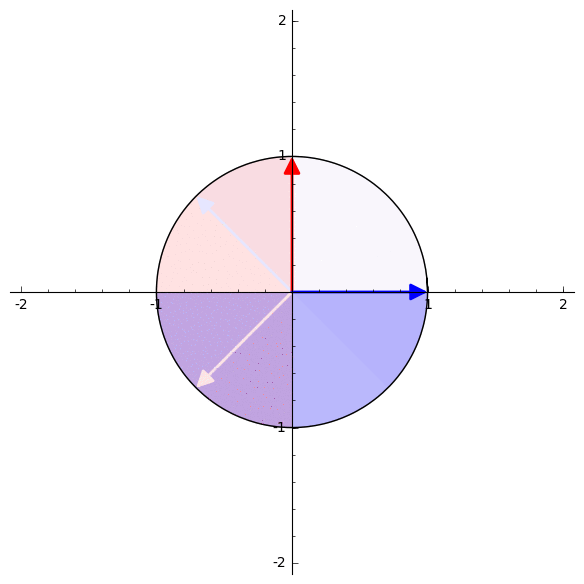

In [103]:
rotation_gif = animate_transformation(rotation(3*pi/4), frames = 100, end_pause = 10)
rotation_gif.save("rotation.gif", delay = 0)
rotation_gif

Animation with 60 frames
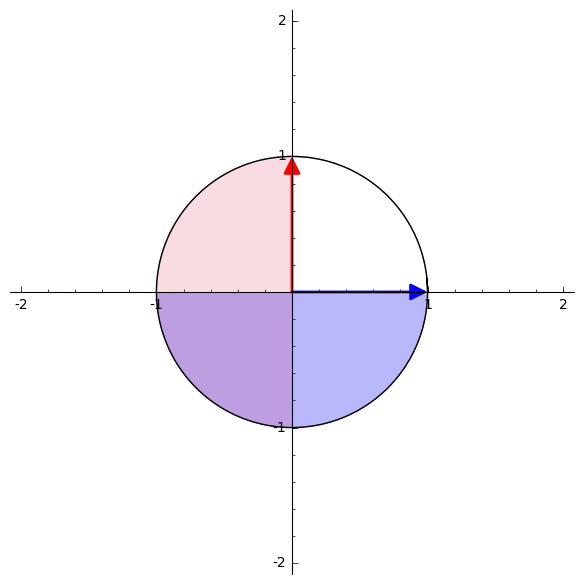

In [92]:
reflection_gif = animate_transformation(reflection(pi/4), frames = 100, end_pause = 10)
reflection_gif.save("reflection.gif", delay = 0)
reflection_gif

## Combining Transformations

In [24]:
def interpolate(*ff):
    ff = list(ff)
    ff.reverse()
    n = float(len(ff))
    def transformation(t):
        result = 1
        for k, f in enumerate(ff):
            if t < k/n:
                result = f(0.0) * result
            elif k/n <= t <= (k/n + 1/n):
                result = f(n*t - k) * result
            else:
                result = f(1.0) * result
        return result
    return transformation

[0.50 -1.5]
[0.50  1.5]

Animation with 50 frames
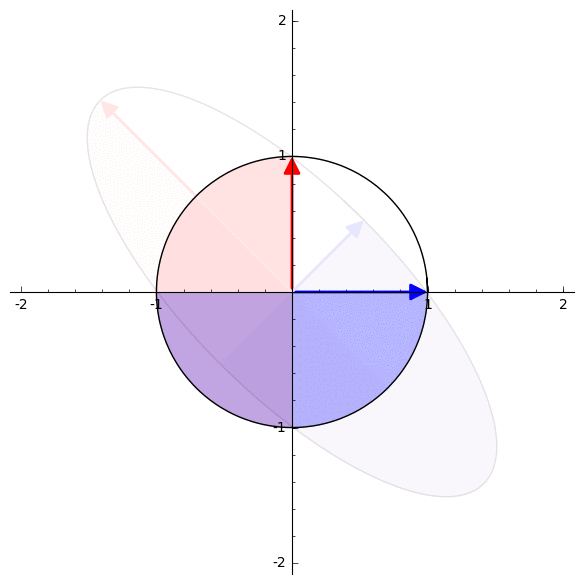

In [15]:
A = interpolate(rotation(pi/4), scaling(0.75, 2))
show(A(1.0).n(2))
animate_transformation(A, steps = 50)

In [12]:
A = interpolate(reflection(pi/4), rotation(-pi/3), scaling(0.75, 1.25))
show(A(1.0).n(2))
animate_transformation(A, steps = 50)

[-0.50  0.50]
[ 0.38  0.75]

Animation with 50 frames

## Factoring Transformations

In [22]:
def make_reflection_rotation(U):
    # check for reflection
    if round(U[0,0]) == round(U[1,1]) and round(det(U)) == 1:
        theta = arccos(U[0,0])
        print("rot", theta)
        return rotation(theta)
    # if it's not a rotation, it's a reflection
    else:
        theta = sgn(U[0,1])*0.5*arccos(U[0,0])
        print("ref", theta)
        return reflection(theta)

def factor_and_interpolate(A):
    A = matrix(RDF, A)
    U, S, V = A.SVD()
    show(U, S, V)
    U_t = make_reflection_rotation(U)
    S_t = scaling(S[0,0], S[1, 1])
    V_t = make_reflection_rotation(V.transpose())
    A_t = interpolate(U_t, S_t, V_t)
    return A_t

('rot', 0.0)
('rot', 0.0)


[ 2.0 0.00]
[0.00  1.0]

Animation with 50 frames
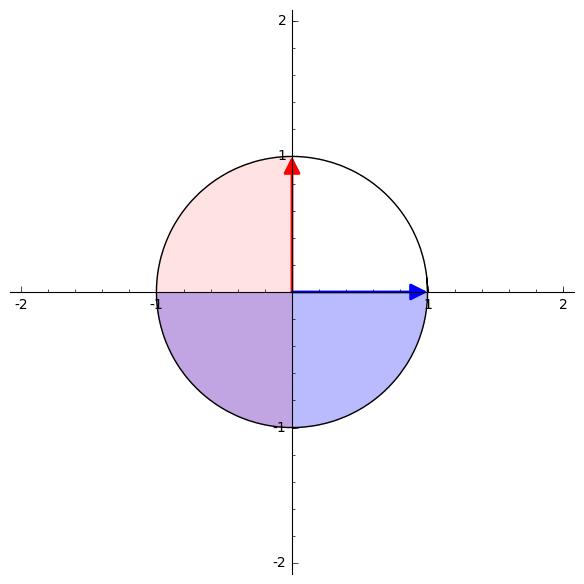

In [250]:
A = factor_and_interpolate([[2, 0], [0, 1]])
show(A(1.0).n(2))
animate_transformation(A, steps = 50)

[0.75  2.0]
[ 2.0  1.0]

[-0.7071067811865475 -0.7071067811865474]
[-0.7071067811865474  0.7071067811865475] [2.0000000000000004                0.0]
[               0.0 0.9999999999999998] [-0.7071067811865475  0.7071067811865475]
[-0.7071067811865475 -0.7071067811865475]

('ref', -1.17809724509617)
('rot', 2.356194490192345)


Animation with 210 frames
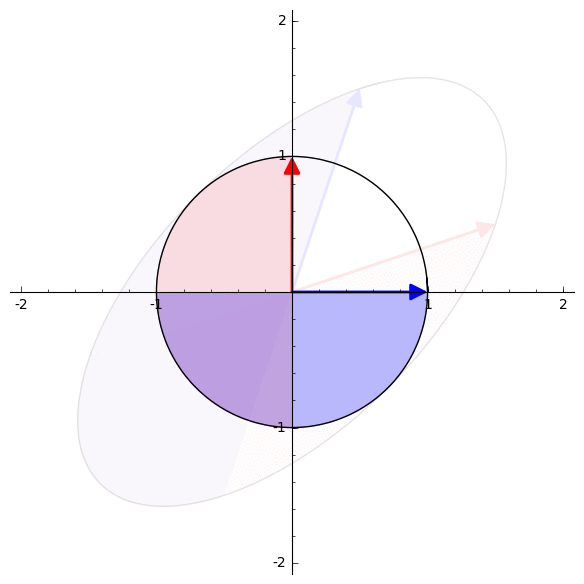

In [79]:
show(A(1.0).n(2))
A = factor_and_interpolate([[0.5, 1.5], [1.5, 0.5]])
a = animate_transformation(A, steps = 200, end_pause = 10)
a.save("rot-scale-ref.gif", delay = 0)
show(a)

[-1.0  0.0]
[ 0.0 -1.0] [2.0 0.0]
[0.0 1.0] [ 0.0 -1.0]
[ 1.0 -0.0]

('rot', 3.141592653589793)
('rot', 1.5707963267948966)


[-2.2e-16      2.0]
[    -1.0 -3.3e-16]

Animation with 210 frames
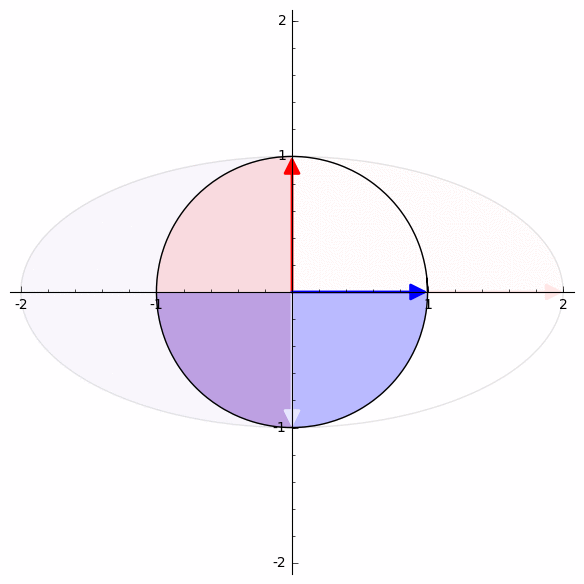

In [27]:
A = factor_and_interpolate([[0, -2], [1, 0]])
show(A(1.0).n(2))
a = animate_transformation(A, steps = 200, end_pause = 10)
a.save("rot-scale-rot.gif", delay = 0)
show(a)

[ 0.8506508083520399 -0.5257311121191336]
[ 0.5257311121191336  0.8506508083520399] [ 1.618033988749895                0.0]
[               0.0 0.6180339887498948] [0.5257311121191336  -0.85065080835204]
[  0.85065080835204 0.5257311121191336]

('rot', 0.5535743588970453)
('rot', 1.0172219678978514)


[ 0.50  -1.5]
[  1.0 -0.50]

Animation with 210 frames
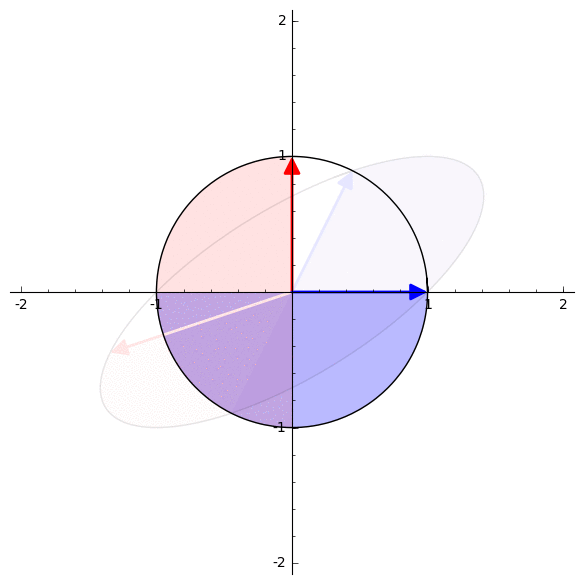

In [33]:
A = factor_and_interpolate([[1, 1], [0, 1]])
show(A(1.0).n(2))
a = animate_transformation(A, steps = 200, end_pause = 10)
a.save("shear.gif", delay = 0)
show(a)